# Crossview - Simplified

***look at pix2pix***

## Introduction

using device: cuda


Epoch 1/20: 100%|██████████| 135/135 [02:30<00:00,  1.11s/it]


Epoch [1/20], Train Loss: 2.8588


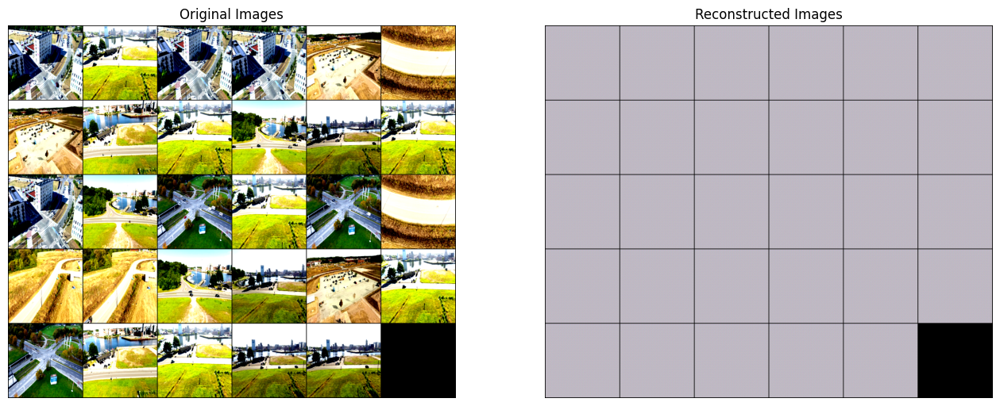

Epoch [1], Validation Loss: 2.8679


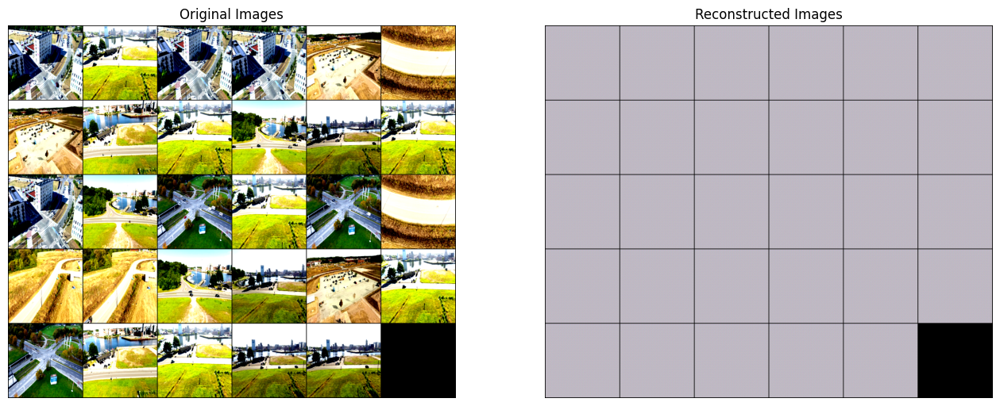

Epoch 2/20: 100%|██████████| 135/135 [02:30<00:00,  1.11s/it]


Epoch [2/20], Train Loss: 2.8347


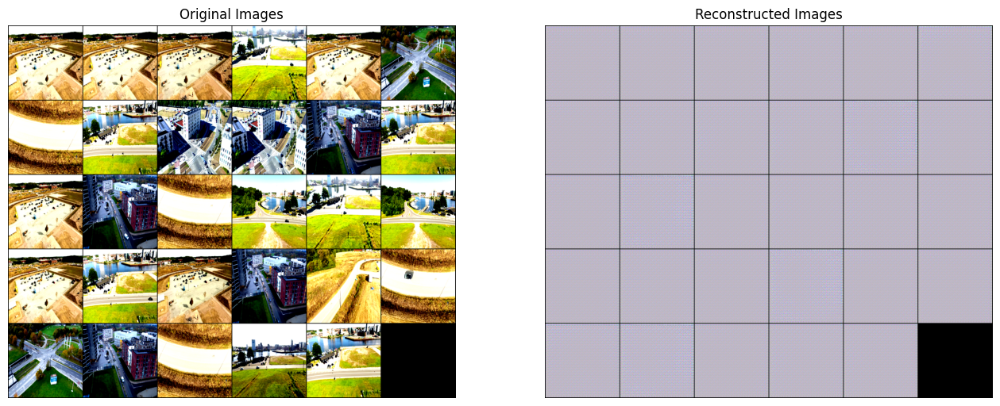

Epoch [2], Validation Loss: 2.8444


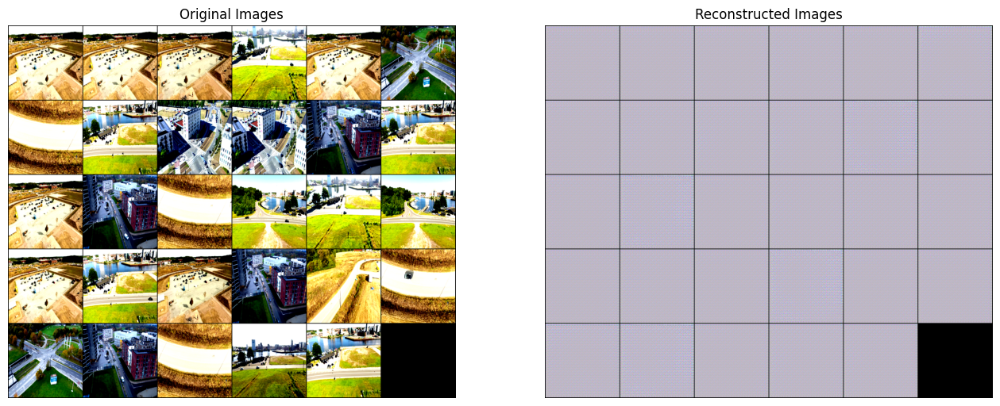

Epoch 3/20: 100%|██████████| 135/135 [02:30<00:00,  1.12s/it]


Epoch [3/20], Train Loss: 2.7850


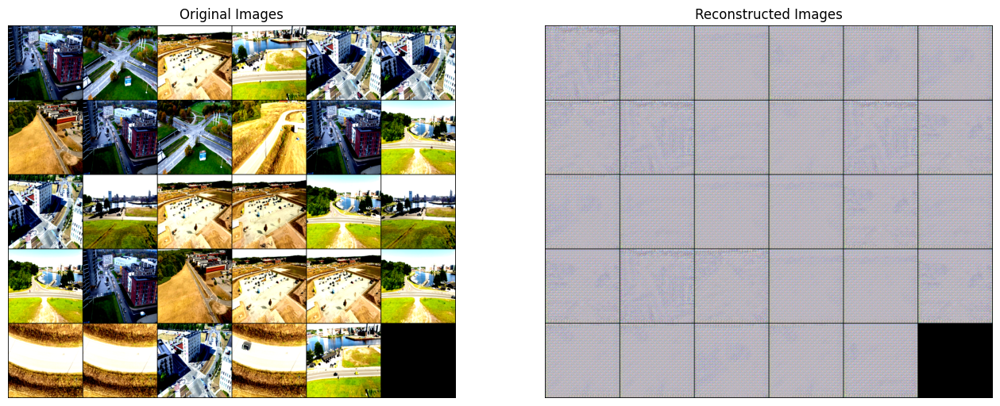

Epoch [3], Validation Loss: 2.7910


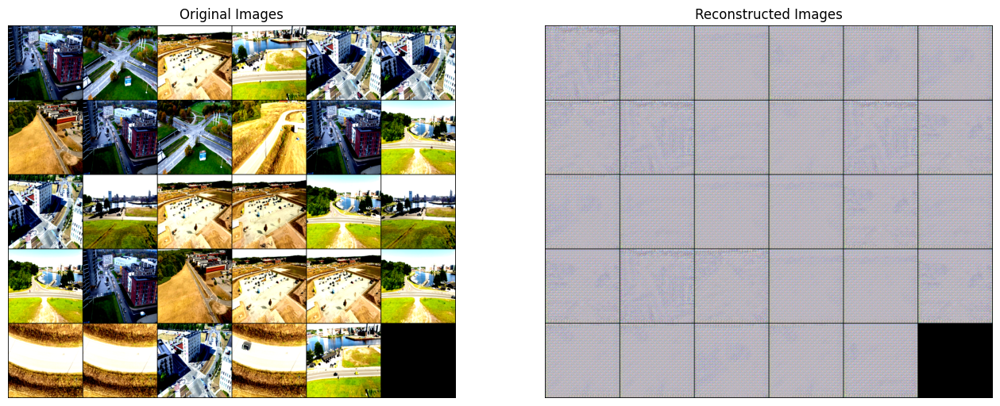

Epoch 4/20: 100%|██████████| 135/135 [02:32<00:00,  1.13s/it]


Epoch [4/20], Train Loss: 2.7364


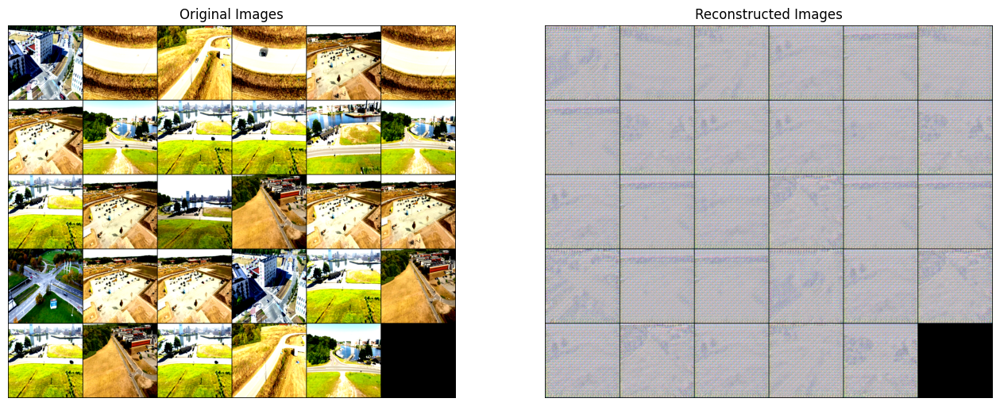

Epoch [4], Validation Loss: 2.6995


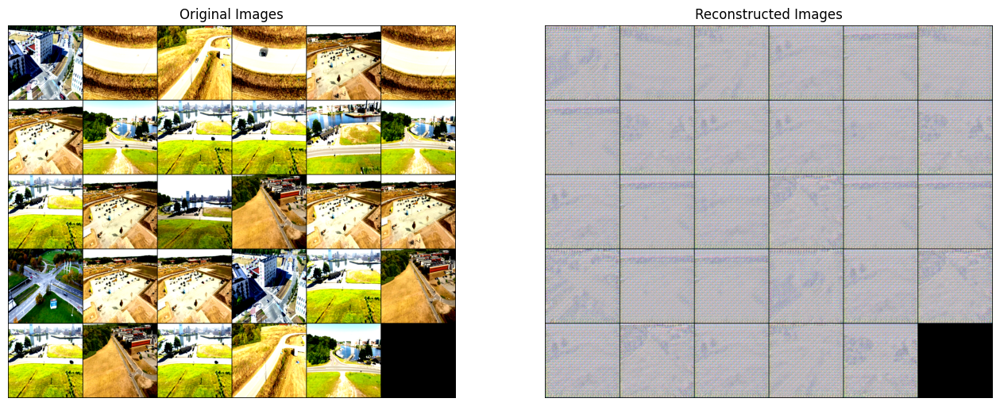

Epoch 5/20: 100%|██████████| 135/135 [02:31<00:00,  1.12s/it]


Epoch [5/20], Train Loss: 2.6720


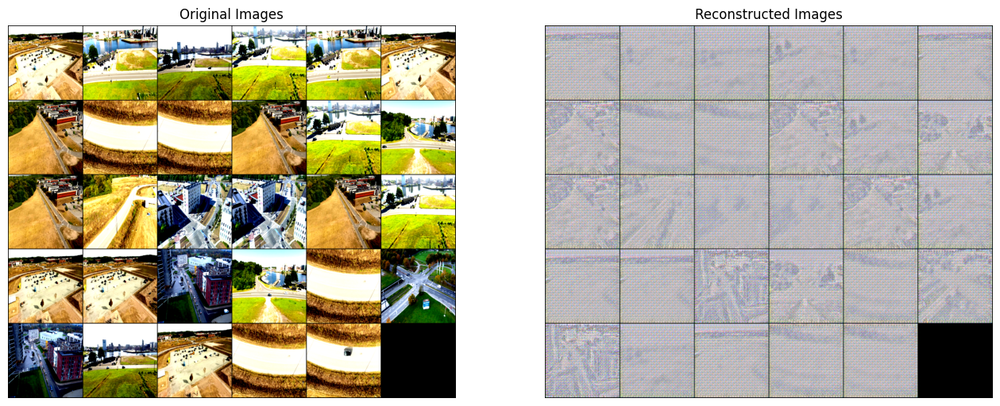

Epoch [5], Validation Loss: 2.6408


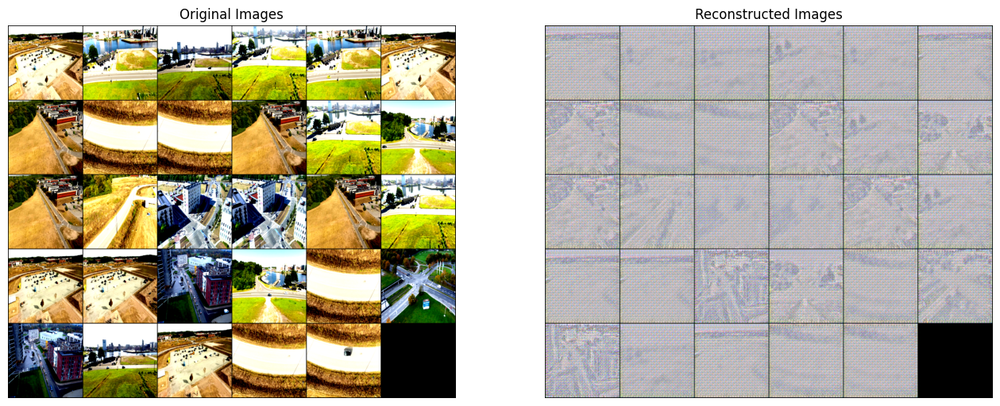

Epoch 6/20: 100%|██████████| 135/135 [02:29<00:00,  1.10s/it]


Epoch [6/20], Train Loss: 2.6108


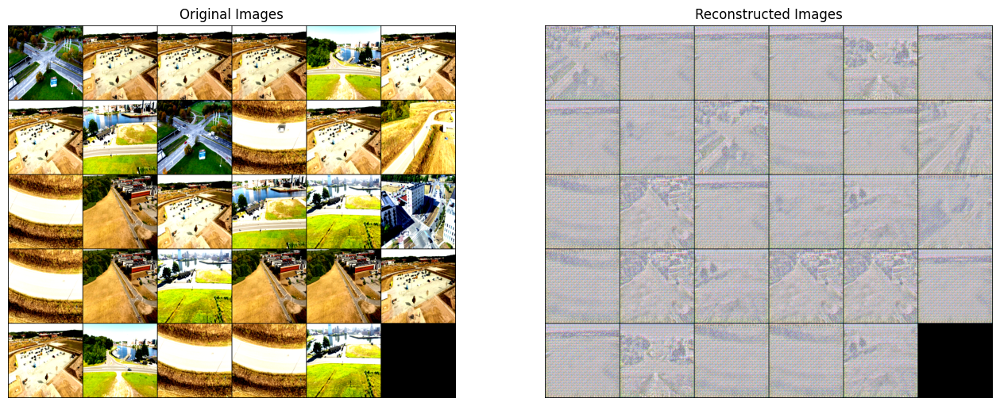

Epoch [6], Validation Loss: 2.5751


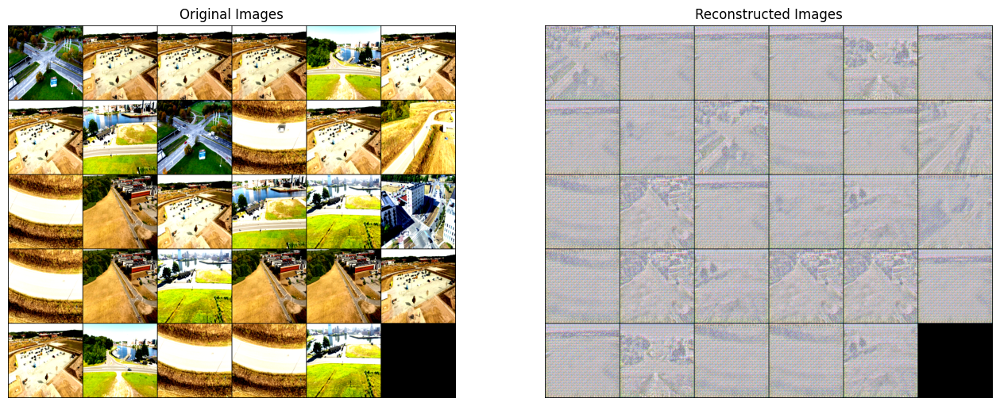

Epoch 7/20: 100%|██████████| 135/135 [02:30<00:00,  1.12s/it]


Epoch [7/20], Train Loss: 2.5132


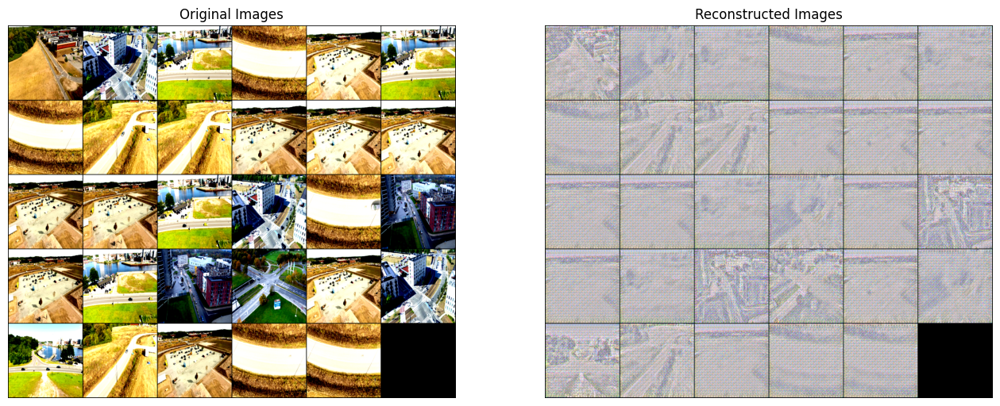

Epoch [7], Validation Loss: 2.5039


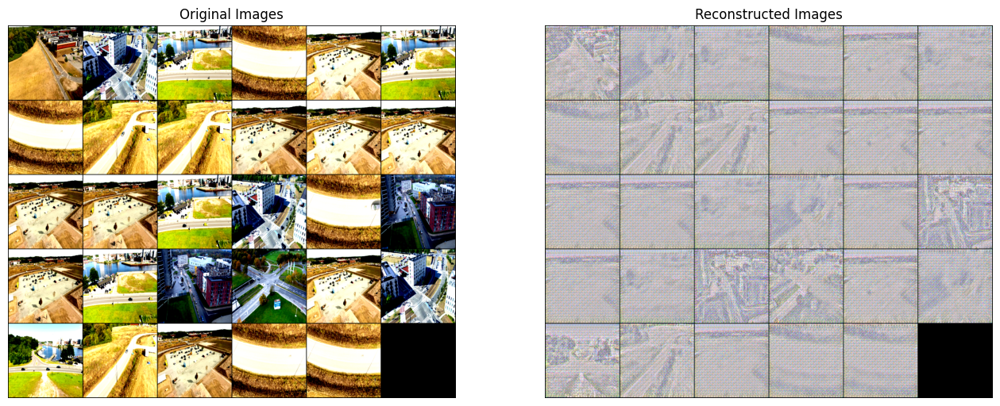

Epoch 8/20: 100%|██████████| 135/135 [02:30<00:00,  1.11s/it]


Epoch [8/20], Train Loss: 2.4577


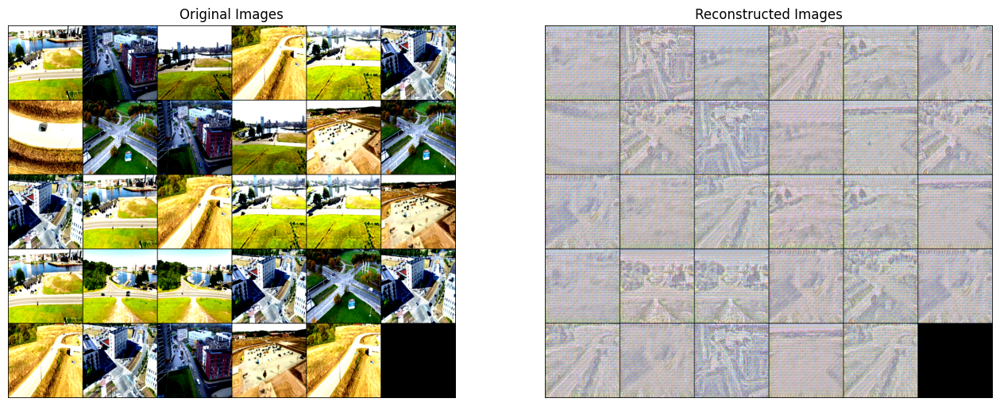

Epoch [8], Validation Loss: 2.4628


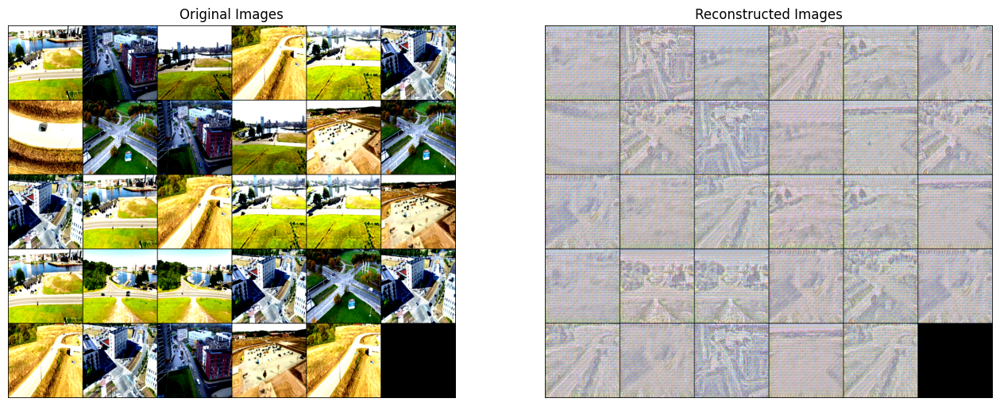

Epoch 9/20: 100%|██████████| 135/135 [02:30<00:00,  1.11s/it]


Epoch [9/20], Train Loss: 2.4338


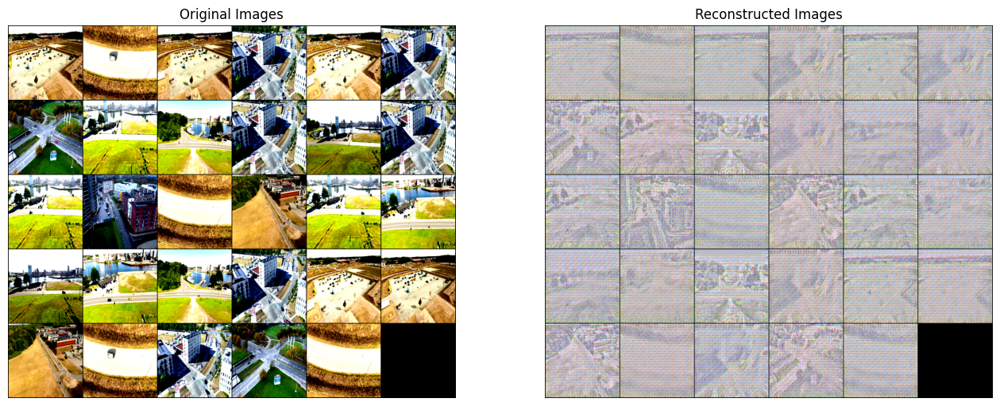

Epoch [9], Validation Loss: 2.4329


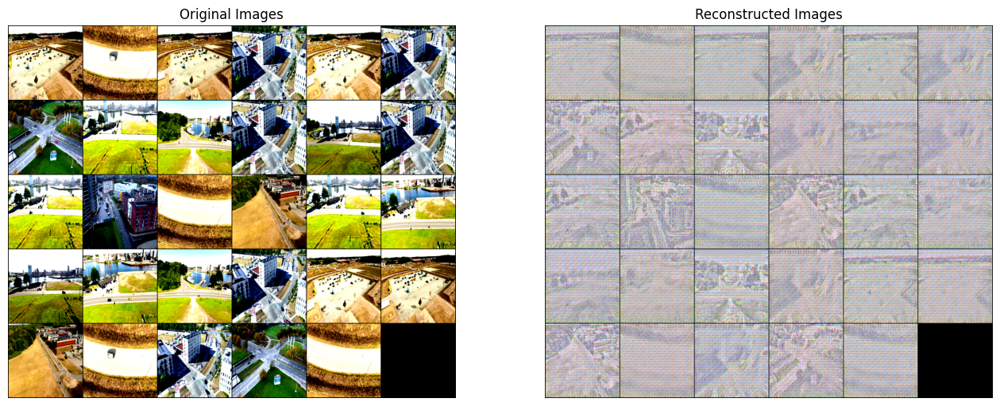

Epoch 10/20: 100%|██████████| 135/135 [02:29<00:00,  1.11s/it]


Epoch [10/20], Train Loss: 2.3957


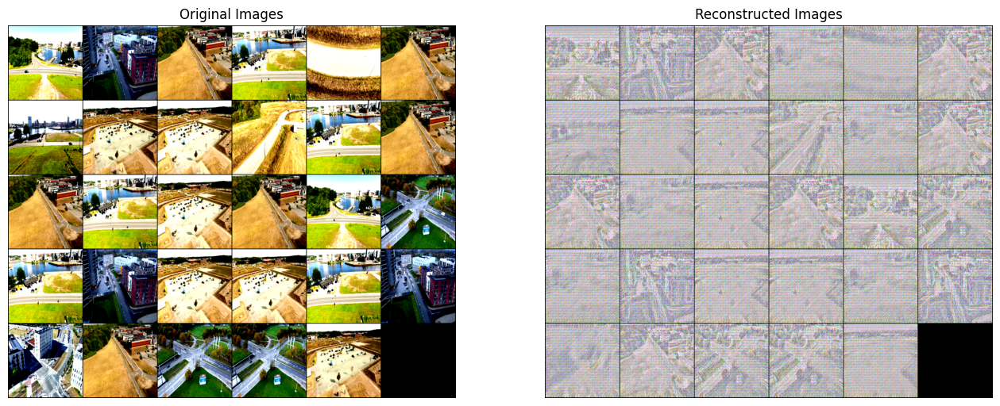

Epoch [10], Validation Loss: 2.4111


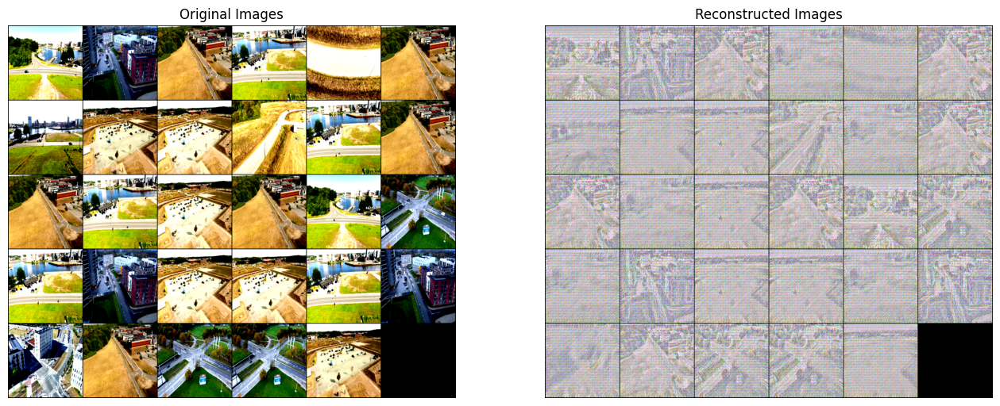

Epoch 11/20: 100%|██████████| 135/135 [02:32<00:00,  1.13s/it]


Epoch [11/20], Train Loss: 2.3864


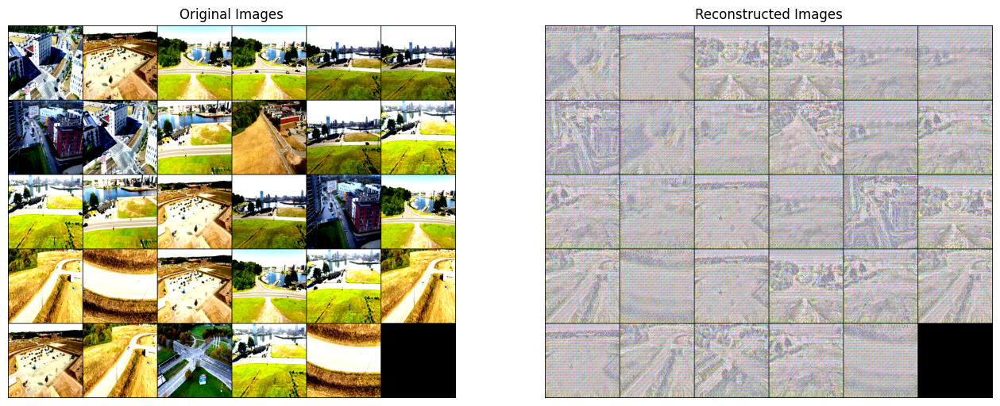

Epoch [11], Validation Loss: 2.4020


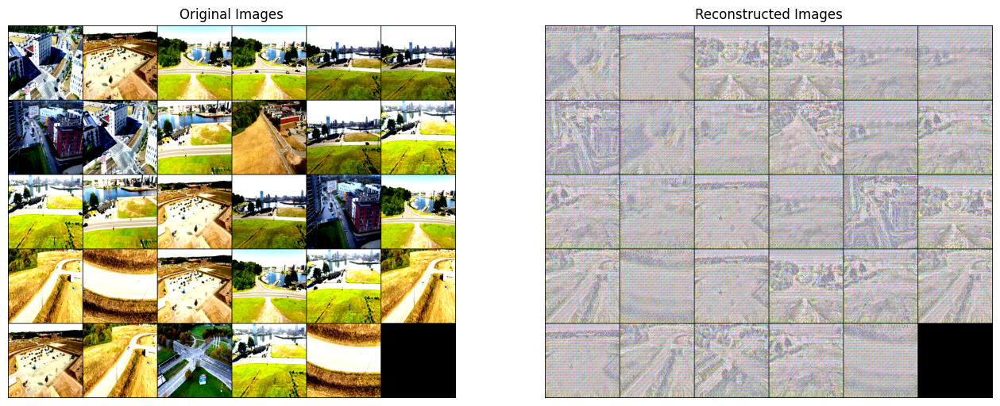

Epoch 12/20: 100%|██████████| 135/135 [02:30<00:00,  1.12s/it]


Epoch [12/20], Train Loss: 2.3595


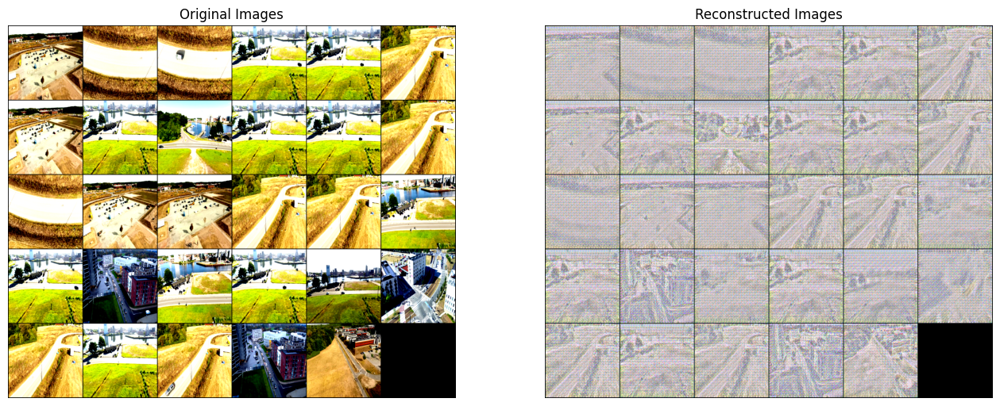

Epoch [12], Validation Loss: 2.3925


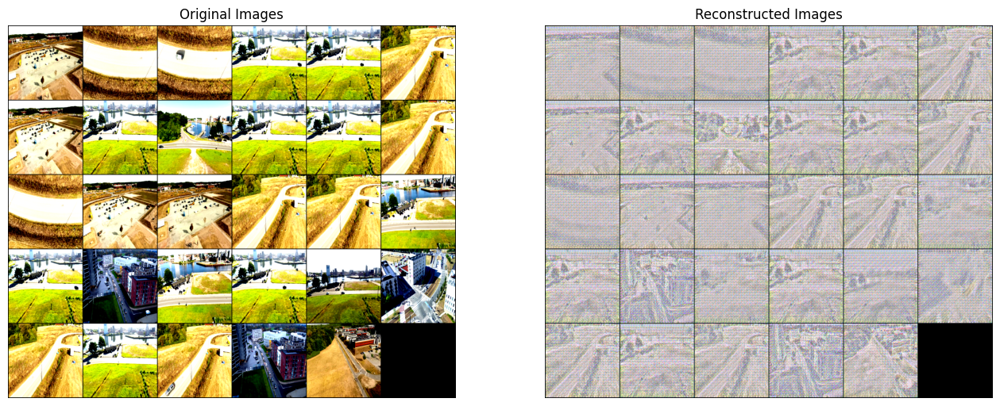

Epoch 13/20: 100%|██████████| 135/135 [02:31<00:00,  1.12s/it]


Epoch [13/20], Train Loss: 2.3419


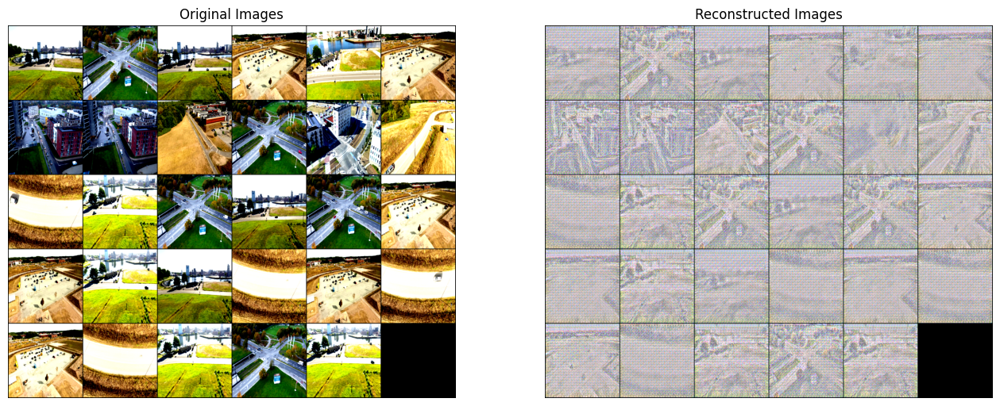

KeyboardInterrupt: 

In [7]:
import torch
import torch.nn as nn
import torch.optim as optim
import os
from PIL import Image
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import make_grid
from tqdm import tqdm
from torchvision.transforms.functional import to_tensor, to_pil_image
import matplotlib.pyplot as plt
import shutil
import math
import timm
from extras import PerceptualLoss


def denormalize(tensor):
    mean = torch.tensor([0.5, 0.5, 0.5]).view(-1, 1, 1).to(tensor.device)
    std = torch.tensor([0.5, 0.5, 0.5]).view(-1, 1, 1).to(tensor.device)
    tensor = tensor * std + mean    # denormalize
    tensor = tensor.clamp(0, 1)     # clamp to range [0, 1]
    return tensor


def save_model(model, path):
    torch.save(model.state_dict(), path)


def visualize_reconstruction(original, reconstructed, epoch, idx, device):
    # Assuming original and reconstructed are tensors of shape (B, C, H, W)
    fig, axs = plt.subplots(1, 2, figsize=(16, 8))
    original = make_grid(denormalize(original).cpu(), nrow=6)
    reconstructed = make_grid(denormalize(reconstructed).cpu(), nrow=6)

    axs[0].imshow(original.permute(1, 2, 0))
    axs[0].set_title('Original Images')
    axs[0].axis('off')

    axs[1].imshow(reconstructed.permute(1, 2, 0))
    axs[1].set_title('Reconstructed Images')
    axs[1].axis('off')

    plt.show()


class Encoder(nn.Module):
    def __init__(self, pretrained_model_name='vit_base_patch16_224', out_features=100):
        super(Encoder, self).__init__()
        self.vit = timm.create_model(pretrained_model_name, pretrained=True)
        self.vit.head = nn.Identity()   # remove the classifier head

        vit_features = self.vit.num_features    # get the number of features in the model
        
        self.reducer = nn.Linear(vit_features, out_features)    # linear layer to map to the default features to the desired output features

    def forward(self, x):
        x = self.vit(x)
        x = self.reducer(x)     # reduce the feature to (out_features x 1)
        return x
    

class Decoder(nn.Module):
    def __init__(self, input_dims=100, hidden_dims=512, output_channels=3, initial_size=7):
        super(Decoder, self).__init__()

        self.fc = nn.Linear(input_dims, hidden_dims * initial_size * initial_size)  # [batch_size, input_dims, 1] -> [batch_size, hidden_dims * initial_size * initial_size] 

        self.input_dims = input_dims
        self.hidden_dims = hidden_dims
        self.output_channels = output_channels
        self.initial_size = initial_size
        
        self.upsample = nn.Sequential(
            nn.ReLU(),
            nn.Unflatten(1, (hidden_dims, initial_size, initial_size)),                                                 # [batch_size, hidden_dims * initial_size * initial_size] -> [batch_size, hidden_dims, initial_size, initial_size]
            nn.ConvTranspose2d(hidden_dims, hidden_dims // 2, kernel_size=3, stride=2, padding=1, output_padding=1),            # 7x7 -> 14x14
            nn.ReLU(),
            nn.ConvTranspose2d(hidden_dims // 2, hidden_dims // 4, kernel_size=3, stride=2, padding=1, output_padding=1),       # 14x14 -> 28x28
            nn.ReLU(),
            nn.ConvTranspose2d(hidden_dims // 4, hidden_dims // 8, kernel_size=3, stride=2, padding=1, output_padding=1),       # 28x28 -> 56x56
            nn.ReLU(),
            nn.ConvTranspose2d(hidden_dims // 8, hidden_dims // 16, kernel_size=3, stride=2, padding=1, output_padding=1),      # 56x56 -> 112x112
            nn.ReLU(),
            nn.ConvTranspose2d(hidden_dims // 16, output_channels, kernel_size=3, stride=2, padding=1, output_padding=1),     # 112x112 -> 224x224
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.fc(x)
        # x = x.view(-1, self.hidden_dims, self.initial_size, self.initial_size)
        x = self.upsample(x)
        return x
    
    
class CustomDataset(Dataset):
    def __init__(self, directory, transform=None):
        self.directory = directory
        self.transform = transform
        self.image_paths = [os.path.join(directory, fname) for fname in os.listdir(directory) if fname.endswith('.PNG')]    # lists all PNG files in the directory

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        image = Image.open(image_path).convert('RGB')  # Convert image to RGB
        
        if self.transform:
            image = self.transform(image)
        
        return image


# ----- Setup ----- #

image_channels = 3      # for RGB images
image_size = 224        # assuming square images
hidden_dims = 512       # hidden dimensions
output_dims = 1000       # size of phi
batch_size = 64
shuffle = True

# Select device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"using device: {device}")

# Initialize the encoder and decoder
encoder = Encoder(pretrained_model_name='vit_base_patch16_224', out_features=output_dims).to(device)
decoder = Decoder(input_dims=output_dims, hidden_dims=hidden_dims, output_channels=3, initial_size=7).to(device)
encoder.to(device)
decoder.to(device)

# Optimizer and Loss Function
learning_rate = 1e-3
optimizer = optim.Adam(list(encoder.parameters()) + list(decoder.parameters()), lr=learning_rate)
perceptual_loss = PerceptualLoss().to(device)
# criterion = nn.MSELoss()
criterion = perceptual_loss

# Transformations
transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.CenterCrop((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Define the Datasets
train_dataset = CustomDataset('dataset/labelled/train/aerial', transform=transform)
val_dataset = CustomDataset('dataset/labelled/val/aerial', transform=transform)

# Define the DataLoaders
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=shuffle, num_workers=4)
val_dataloader = DataLoader(val_dataset, batch_size=32, shuffle=False)


# ----- Training ----- #

def train(encoder, decoder, train_loader, val_loader, device, criterion, optimizer, epochs=10, save_path='models'):

    encoder.to(device)
    decoder.to(device)

    for epoch in range(epochs):

        encoder.train()
        decoder.train()

        running_loss = 0.0

        for images in tqdm(train_loader, desc=f'Epoch {epoch+1}/{epochs}'):

            images = images.to(device)

            optimizer.zero_grad()

            encoded_imgs = encoder(images)
            decoded_imgs = decoder(encoded_imgs)

            loss = criterion(decoded_imgs, images)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()


        avg_loss = running_loss / len(train_loader)
        print(f'Epoch [{epoch+1}/{epochs}], Train Loss: {avg_loss:.4f}')

        visualize_reconstruction(images, decoded_imgs, epoch, 0, device)
        
        # Perform Validation
        validate(encoder, decoder, val_loader, criterion, device, epoch)

        # Visualize the Reconstruction
        visualize_reconstruction(images, decoded_imgs, epoch, 0, device)

        # Save the Model
        os.makedirs(save_path, exist_ok=True)
        torch.save(encoder.state_dict(), os.path.join(save_path, f'encoder_epoch_{epoch+1}.pth'))
        torch.save(decoder.state_dict(), os.path.join(save_path, f'decoder_epoch_{epoch+1}.pth'))


def validate(encoder, decoder, loader, criterion, device, epoch):
    encoder.eval()
    decoder.eval()

    with torch.no_grad():
        validation_loss = 0.0
        for images in loader:
            images = images.to(device)
            encoded_imgs = encoder(images)
            decoded_imgs = decoder(encoded_imgs)
            loss = criterion(decoded_imgs, images)
            validation_loss += loss.item()

        avg_val_loss = validation_loss / len(loader)
        print(f'Epoch [{epoch+1}], Validation Loss: {avg_val_loss:.4f}')


train(encoder, decoder, train_dataloader, val_dataloader, device, criterion, optimizer, epochs=20, save_path='models')



In [ ]:
# ----- Inference ----- #

def inference(input_dir, output_dir):

    output_dir = os.path.join('inference', output_dir)
    
    if not os.path.exists(output_dir):      # create the output directory if it doesn't exist
        os.makedirs(output_dir)
    
    image_paths = [os.path.join(input_dir, fname) for fname in os.listdir(input_dir) if fname.endswith('.PNG')]     # lists all PNG files in the directory
    
    for image_path in tqdm(image_paths, desc="Performing Inference"):
        
        image = Image.open(image_path).convert('RGB')       # load and transform the image
        image = transform(image).unsqueeze(0).to(device)
        
        # Perform inference
        with torch.no_grad():
            phi = encoder(image)
            recon_image = decoder(phi)
        
        # Convert tensors to PIL images for saving
        original_image = to_pil_image(denormalize(image.squeeze().cpu()))
        reconstructed_image = to_pil_image(denormalize(recon_image.squeeze().cpu()))
        
        # Extract filename and prepare output paths
        filename = os.path.basename(image_path)
        original_image_path = os.path.join(output_dir, f"original_{filename}")
        reconstructed_image_path = os.path.join(output_dir, f"reconstructed_{filename}")

        print("Original Image Stats:")
        print(f"Min: {image.min().item()}")
        print(f"Max: {image.max().item()}")
        print(f"Mean: {image.mean().item()}")

        print("Reconstructed Image Stats:")
        print(f"Min: {recon_image.min().item()}")
        print(f"Max: {recon_image.max().item()}")
        print(f"Mean: {recon_image.mean().item()}")
        
        # Save images
        original_image.save(original_image_path)
        reconstructed_image.save(reconstructed_image_path)


encoder.eval()
decoder.eval()


# Specify the input directory and the output directory
input_dir = 'test'  # Update as needed
output_dir = 'inference'  # The folder where original and result images will be saved

# Perform inference and save results
inference(input_dir, output_dir)

Performing Inference:  50%|█████     | 2/4 [00:00<00:00,  7.85it/s]

Original Image Stats:
Min: -1.7754088640213013
Max: 2.6051416397094727
Mean: -0.38242605328559875
Reconstructed Image Stats:
Min: 3.549919052409713e-17
Max: 0.9999998807907104
Mean: 0.3928007185459137
Original Image Stats:
Min: -2.1179039478302
Max: 2.4482791423797607
Mean: 0.01913018338382244
Reconstructed Image Stats:
Min: 3.368639731309714e-13
Max: 0.9999997615814209
Mean: 0.4011317193508148


Performing Inference: 100%|██████████| 4/4 [00:00<00:00,  8.78it/s]

Original Image Stats:
Min: -1.9466564655303955
Max: 2.430849552154541
Mean: -0.605549156665802
Reconstructed Image Stats:
Min: 2.450818074962179e-18
Max: 1.0
Mean: 0.3780840337276459
Original Image Stats:
Min: -1.9637812376022339
Max: 2.552854299545288
Mean: 0.38105106353759766
Reconstructed Image Stats:
Min: 2.4014188415577564e-09
Max: 0.9998248219490051
Mean: 0.4076541066169739


### Visualize Transformations

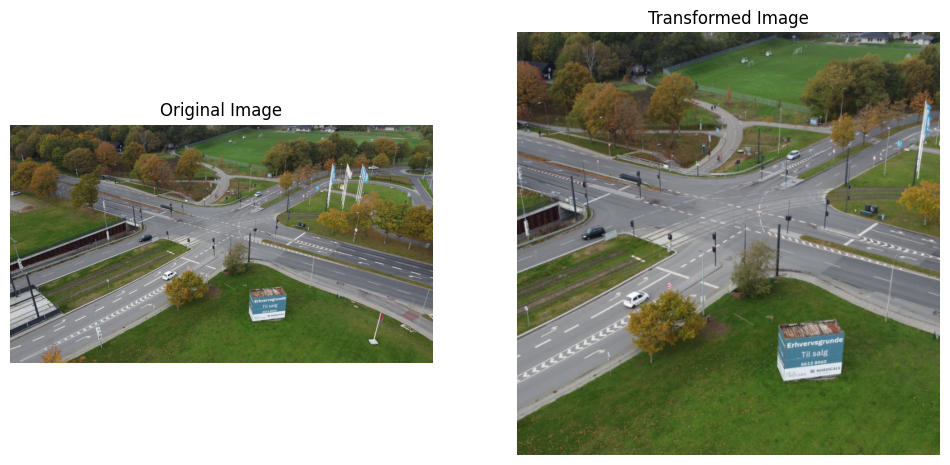

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_pil_image

image_size = 512        # assuming square images

# Transformations
transform = transforms.Compose([
    transforms.Resize(image_size),  # Resize the shortest edge to image_size
    transforms.CenterCrop((image_size, image_size)),  # Crop the center square of the image
    transforms.ToTensor(),  # Convert images to Torch tensors
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])  # Normalize images
])


# Load Sample Image
image_path = 'dataset/labelled/train/aerial/scene_1_Cortex_Park_crossroads_drone_000000.PNG'  # Update this to the path of your image
image = Image.open(image_path).convert('RGB')

# Apply the transformation
transformed_image = transform(image)

# Denormalize the transformed image
denormalized_transformed_image = denormalize(transformed_image.squeeze())

# Convert denormalized image back to PIL for displaying
denormalized_transformed_image_pil = to_pil_image(denormalized_transformed_image)

# Display the original and denormalized transformed images
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(image)
axs[0].set_title('Original Image')
axs[0].axis('off')

axs[1].imshow(denormalized_transformed_image_pil)
axs[1].set_title('Transformed Image')
axs[1].axis('off')

plt.show()


## Training

## Validation

## Inference

In [ ]:
# from torchvision.transforms.functional import to_tensor, to_pil_image
# import matplotlib.pyplot as plt


# # Initialize the models
# encoder = Encoder(image_channels, hidden_dims, output_dims).to(device)
# decoder = Decoder(output_dims, hidden_dims, image_channels, image_size).to(device)

# # Load the saved model weights
# encoder.load_state_dict(torch.load('encoder_model.pth', map_location=device))
# decoder.load_state_dict(torch.load('decoder_model.pth', map_location=device))

# # Set the models to evaluation mode
# encoder.eval()
# decoder.eval()


# def preprocess_image(image_path):
#     image = Image.open(image_path).convert('RGB')
#     image = transforms.Resize((64, 64))(image)  # Resize to the same size as during training
#     image = to_tensor(image)  # Convert to tensor
#     image = transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])(image)  # Normalize
#     return image.unsqueeze(0).to(device)  # Add batch dimension and send to device


# def infer_and_plot(image_path):
#     # Preprocess the image
#     image = preprocess_image(image_path)
    
#     # Perform inference
#     with torch.no_grad():
#         phi = encoder(image)
#         recon_image = decoder(phi)
    
#     # Convert images to PIL for visualization
#     image = to_pil_image(image.squeeze().cpu())
#     recon_image = to_pil_image(recon_image.squeeze().cpu())
    
#     # Plotting
#     fig, ax = plt.subplots(1, 2, figsize=(12, 6))
#     ax[0].imshow(image)
#     ax[0].set_title('Original Image')
#     ax[0].axis('off')
    
#     ax[1].imshow(recon_image)
#     ax[1].set_title('Reconstructed Image')
#     ax[1].axis('off')
    
#     plt.show()

# # Example usage
# image_path = 'dataset/labelled/val/aerial/scene_1_Cortex_Park_crossroads_drone_000017.PNG'
# infer_and_plot(image_path)
